In [1]:
import numpy as np
import matplotlib.pyplot as plt
import read_emcee_samples as res
import bayesian as ba
import imrtestgr as tgr
import scipy
from scipy import interpolate
from IPython.display import Image, display

In [2]:
# Module for confidence calculations
class confidence(object):
  def __init__(self, counts):
    # Sort in descending order in frequency
    self.counts_sorted = np.sort(counts.flatten())[::-1]
    # Get a normalized cumulative distribution from the mode
    self.norm_cumsum_counts_sorted = np.cumsum(self.counts_sorted) / np.sum(counts)
    # Set interpolations between heights, bins and levels
    self._set_interp()
  def _set_interp(self):
    self._length = len(self.counts_sorted)
    # height from index
    self._height_from_idx = interpolate.interp1d(np.arange(self._length), self.counts_sorted, bounds_error=False, fill_value=0.)
    # index from height
    self._idx_from_height = interpolate.interp1d(self.counts_sorted[::-1], np.arange(self._length)[::-1], bounds_error=False, fill_value=self._length)
    # level from index
    self._level_from_idx = interpolate.interp1d(np.arange(self._length), self.norm_cumsum_counts_sorted, bounds_error=False, fill_value=1.)
    # index from level
    self._idx_from_level = interpolate.interp1d(self.norm_cumsum_counts_sorted, np.arange(self._length), bounds_error=False, fill_value=self._length)
  def level_from_height(self, height):
    return self._level_from_idx(self._idx_from_height(height))
  def height_from_level(self, level):
    return self._height_from_idx(self._idx_from_level(level))

# compute 1-sigma confidence intervals in 1D 
def calc_cred_intervals_in_1d(P, x):

        # find the value of P corresponding to 50% and 9% confidence heights 
        conf = confidence(P)
        P_s1 = conf.height_from_level(0.5)
        P_s2 = conf.height_from_level(0.9)

        # calculation of condifence edges (values of x corresponding to the height s1 on the two sides) 
        x_s1_l = min(x[np.where(P >= P_s1)[0]])
        x_s1_r = max(x[np.where(P >= P_s1)[0]])

        # calculation of condifence edges (values of x corresponding to the height s2 on the two sides) 
        x_s2_l = min(x[np.where(P >= P_s2)[0]])
        x_s2_r = max(x[np.where(P >= P_s2)[0]])

        return P_s1, P_s2, x_s1_l, x_s1_r, x_s2_l, x_s2_r

In [3]:
nwalkers, num_iter, ndim = 100, 50000, 11
n_burnin = 45000
iota, psi = 1.57, 0.00

root_dir = '/home/abhirup/Documents/Work/gr_consistency_highermodes/runs/SXS_four_modes_20181223_cosiota_tgr'

param_vec = ['mc', 'q', 'mc1', 'q1','dL', 'i', 't0', 'phi0', 'ra', 'sin_dec', 'pol']

... M=70, iota=1.57, psi=0.00
BBH_SXS


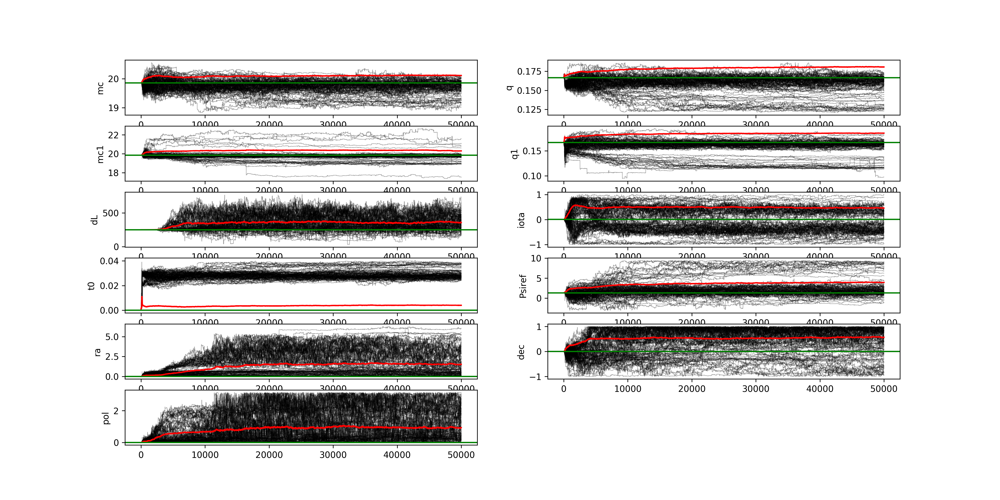

... read samples


/home/abhirup/src/pycbc/lib/python2.7/site-packages/ipykernel_launcher.py:28: MatplotlibDeprecationWarning: The hold function was deprecated in version 2.0.


NSBH_SXS


/home/abhirup/src/pycbc/lib/python2.7/site-packages/ipykernel_launcher.py:84: MatplotlibDeprecationWarning: pyplot.hold is deprecated.
    Future behavior will be consistent with the long-time default:
    plot commands add elements without first clearing the
    Axes and/or Figure.
/home/abhirup/src/pycbc/local/lib/python2.7/site-packages/matplotlib/__init__.py:917: UserWarning: axes.hold is deprecated. Please remove it from your matplotlibrc and/or style files.
  warnings.warn(self.msg_depr_set % key)
/home/abhirup/src/pycbc/local/lib/python2.7/site-packages/matplotlib/rcsetup.py:152: UserWarning: axes.hold is deprecated, will be removed in 3.0
  warnings.warn("axes.hold is deprecated, will be removed in 3.0")


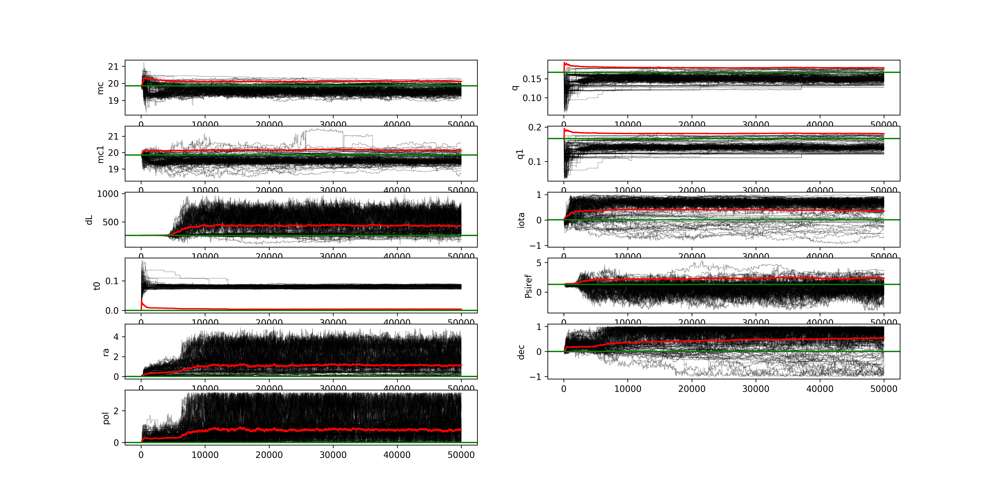

... read samples
BBH_phenomHM


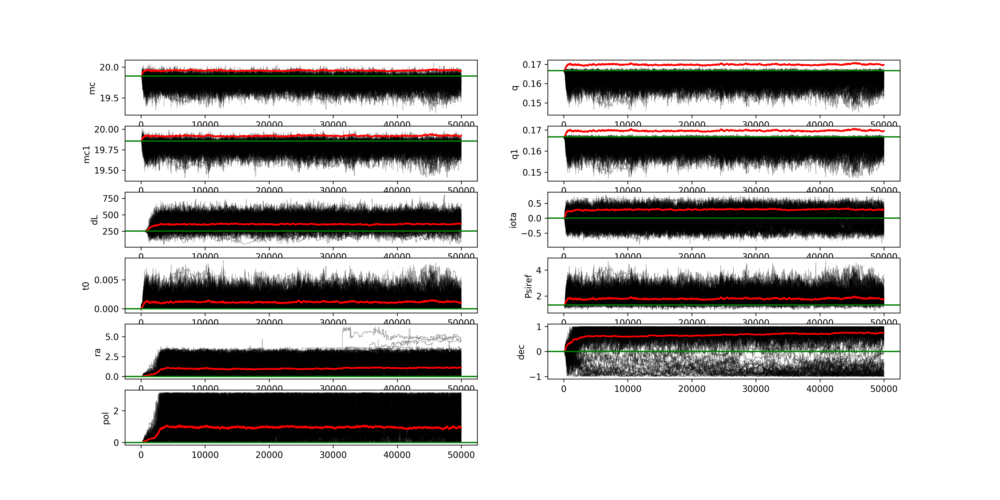

... read samples


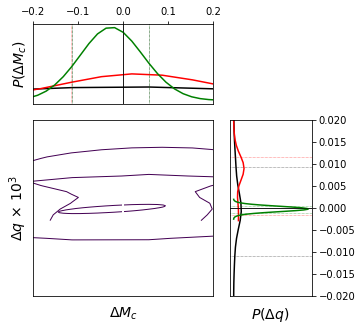

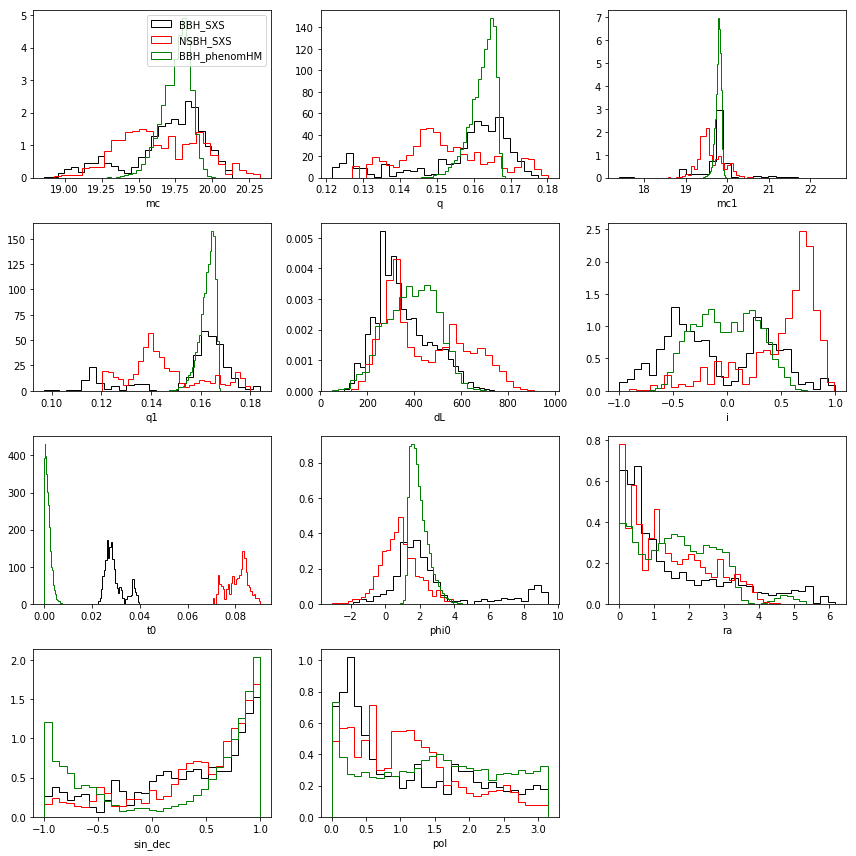

In [4]:
print "... M=70, iota=%.2f, psi=%.2f"%(iota, psi)

plt.figure(figsize=(5,5))
ax1 = plt.subplot2grid((3,3), (0,0), colspan=2)
ax2 = plt.subplot2grid((3,3), (1,2), rowspan=2)
ax3 = plt.subplot2grid((3,3), (1,0), colspan=2, rowspan=2)

p1 = plt.figure(figsize=(12,12))

sxs_bbh_loc = root_dir + '/BBH_M_70.00_iota_%.2f_psi_%.2f_t0_0_sxs'%(iota, psi)
sxs_nsbh_loc = root_dir + '/NSBH_M_70.00_iota_%.2f_psi_%.2f_t0_0_sxs'%(iota, psi)
hm_loc = root_dir + '/BBH_M_70.00_iota_%.2f_psi_%.2f_t0_0_phenomhm'%(iota, psi)
label_map = {sxs_bbh_loc:'BBH_SXS', sxs_nsbh_loc:'NSBH_SXS', hm_loc:'BBH_phenomHM'}
color_map = {sxs_bbh_loc:'k', sxs_nsbh_loc:'r', hm_loc:'g'}

for loc in [sxs_bbh_loc, sxs_nsbh_loc, hm_loc]:
    print label_map[loc]
    
    display(Image(filename=loc + '/samples_chain.png'))
    
    mc, q, mc1, q1, dL, i, t0, phi0, ra, sin_dec, pol = res.read_emcee_samples_11dim(loc + '/emcee_samples.dat', nwalkers, num_iter, ndim, n_burnin)
    samples = mc, q, mc1, q1, dL, i, t0, phi0, ra, sin_dec, pol
    
    print '... read samples'
    for (idx, param) in enumerate(param_vec):
        ax = p1.add_subplot(4,3,idx+1)
        ax.hist(samples[idx], bins=np.linspace(min(samples[idx]), max(samples[idx]), 30), histtype='step', normed=True, label=label_map[loc], color=color_map[loc])
        p1.hold(True)
        plt.xlabel(param)
        if idx == 0:
            plt.legend(loc='best')

    dmc_2d = mc - mc1
    dq_2d = q - q1

    dmc_bins = np.linspace(min(dmc_2d), max(dmc_2d), 30)
    dq_bins = np.linspace(min(dq_2d), max(dq_2d), 30)

    dmc = np.mean(np.diff(dmc_bins))
    dq = np.mean(np.diff(dq_bins))

    dmc_intp = (dmc_bins[:-1] + dmc_bins[1:])/2.
    dq_intp = (dq_bins[:-1] + dq_bins[1:])/2.

    P_dmc_dq_2d, dmc_bins, dq_bins = np.histogram2d(dmc_2d, dq_2d, bins=(dmc_bins, dq_bins), normed=True)
    P_dmc_dq_2d = P_dmc_dq_2d.T
    P_dmc_marg = np.sum(P_dmc_dq_2d, axis=0) * dq
    P_dq_marg = np.sum(P_dmc_dq_2d, axis=1) * dmc

    s1_2d = ba.nsigma_value(P_dmc_dq_2d, 0.5)
    s2_2d = ba.nsigma_value(P_dmc_dq_2d, 0.9)

    s1_marg_v1, s2_marg_v1, left1_marg_v1, right1_marg_v1, left2_marg_v1, right2_marg_v1 = calc_cred_intervals_in_1d(P_dmc_marg, dmc_intp)
    s1_marg_v2, s2_marg_v2, left1_marg_v2, right1_marg_v2, left2_marg_v2, right2_marg_v2 = calc_cred_intervals_in_1d(P_dq_marg, dq_intp)

    ax1.plot(dmc_intp, tgr.gf(P_dmc_marg),color=color_map[loc], lw=1.5)
    ax1.axvline(0.,color='k', ls='-', lw=0.5)
    ax1.axvline(x=left2_marg_v1, color=color_map[loc], ls=':', lw=0.5)
    ax1.axvline(x=right2_marg_v1, color=color_map[loc], ls=':', lw=0.5)
    ax1.set_ylabel('$P(\Delta M_c)$',fontsize=14)
    ax1.set_xlim(-0.2,0.2)
    ax1.xaxis.tick_top()
    ax1.set_yticks([])

    #ax3.pcolormesh(dmc_bins, dq_bins, tgr.gf(P_dmc_dq_2d), cmap='RdPu')
    ax3.contour(dmc_intp, dq_intp, tgr.gf(P_dmc_dq_2d), levels=(s2_2d,s1_2d), linewidths=(1,1.5), color=color_map[loc])
    ax3.plot(0, 0, '+', color='white', ms=12, mew=2) # for mod gr make the marker k+ , for gr make the marker w+
    ax3.set_xlabel('$\Delta M_c ~ (M_\odot)$',fontsize=14, labelpad=10)
    ax3.set_ylabel('$\Delta q \, \\times \, 10^{3}$',fontsize=14)
    ax3.set_xticks([])
    ax3.set_yticks([])
    ax3.set_xlim(-0.2,0.2)
    ax3.set_ylim(-0.02,0.02)

    ax2.plot(tgr.gf(P_dq_marg), dq_intp,color=color_map[loc], lw=1.5)
    ax2.axhline(0.,color='k', ls='-', lw=0.5)
    ax2.axhline(y=left2_marg_v2, color=color_map[loc], ls=':', lw=0.5)
    ax2.axhline(y=right2_marg_v2, color=color_map[loc], ls=':', lw=0.5)
    ax2.set_xlabel('$P(\Delta q)$',fontsize=14, labelpad=10)
    ax2.set_xticks([])
    ax2.set_ylim(-0.02,0.02)
    ax2.yaxis.tick_right()
    plt.tight_layout()
    plt.hold(True)    
        
        
plt.show()

... M=70, iota=1.57, psi=0.00
BBH_SXS


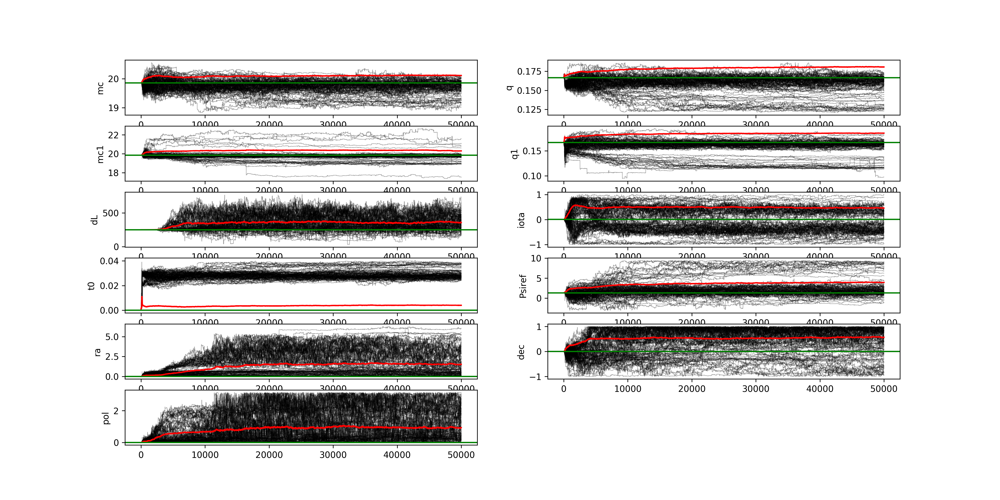

... read samples


/home/abhirup/src/pycbc/lib/python2.7/site-packages/ipykernel_launcher.py:28: MatplotlibDeprecationWarning: The hold function was deprecated in version 2.0.


NSBH_SXS


/home/abhirup/src/pycbc/lib/python2.7/site-packages/ipykernel_launcher.py:84: MatplotlibDeprecationWarning: pyplot.hold is deprecated.
    Future behavior will be consistent with the long-time default:
    plot commands add elements without first clearing the
    Axes and/or Figure.


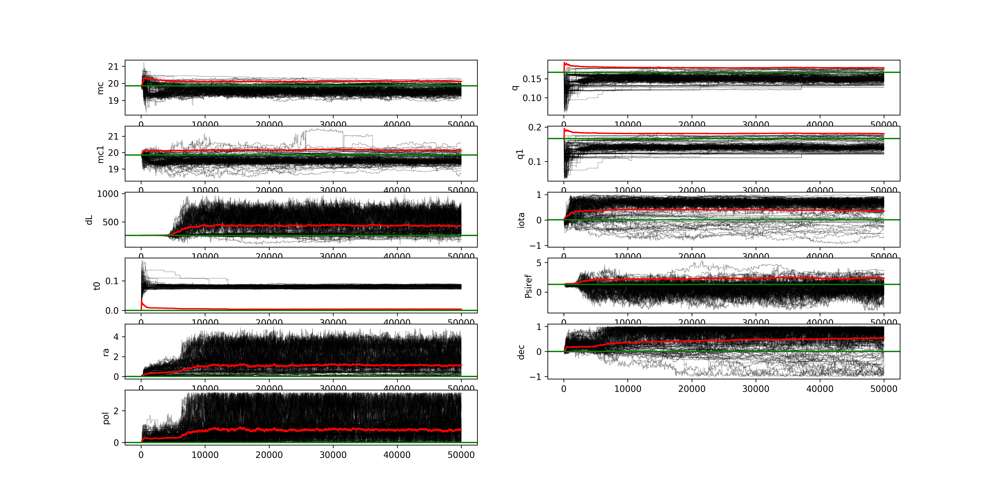

... read samples


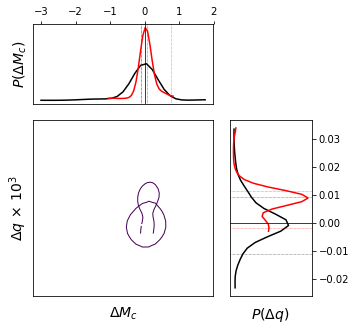

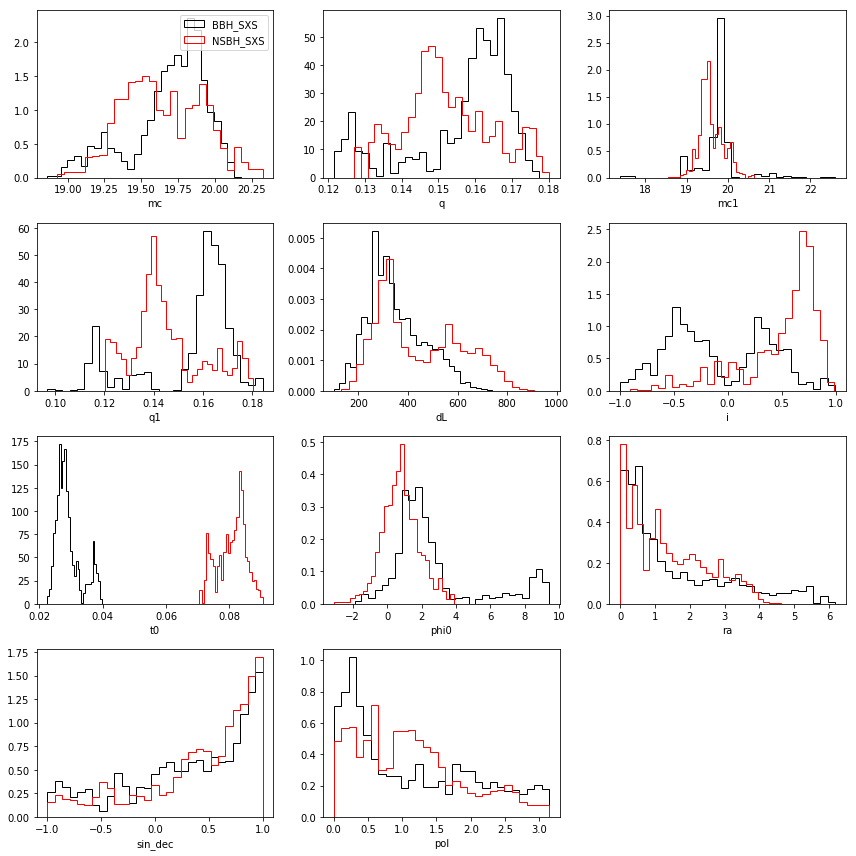

In [5]:
print "... M=70, iota=%.2f, psi=%.2f"%(iota, psi)

plt.figure(figsize=(5,5))
ax1 = plt.subplot2grid((3,3), (0,0), colspan=2)
ax2 = plt.subplot2grid((3,3), (1,2), rowspan=2)
ax3 = plt.subplot2grid((3,3), (1,0), colspan=2, rowspan=2)

p1 = plt.figure(figsize=(12,12))

sxs_bbh_loc = root_dir + '/BBH_M_70.00_iota_%.2f_psi_%.2f_t0_0_sxs'%(iota, psi)
sxs_nsbh_loc = root_dir + '/NSBH_M_70.00_iota_%.2f_psi_%.2f_t0_0_sxs'%(iota, psi)
hm_loc = root_dir + '/BBH_M_70.00_iota_%.2f_psi_%.2f_t0_0_phenomhm'%(iota, psi)
label_map = {sxs_bbh_loc:'BBH_SXS', sxs_nsbh_loc:'NSBH_SXS', hm_loc:'BBH_phenomHM'}
color_map = {sxs_bbh_loc:'k', sxs_nsbh_loc:'r', hm_loc:'g'}

for loc in [sxs_bbh_loc, sxs_nsbh_loc]:
    print label_map[loc]
    
    display(Image(filename=loc + '/samples_chain.png'))
    
    mc, q, mc1, q1, dL, i, t0, phi0, ra, sin_dec, pol = res.read_emcee_samples_11dim(loc + '/emcee_samples.dat', nwalkers, num_iter, ndim, n_burnin)
    samples = mc, q, mc1, q1, dL, i, t0, phi0, ra, sin_dec, pol
    
    print '... read samples'
    for (idx, param) in enumerate(param_vec):
        ax = p1.add_subplot(4,3,idx+1)
        ax.hist(samples[idx], bins=np.linspace(min(samples[idx]), max(samples[idx]), 30), histtype='step', normed=True, label=label_map[loc], color=color_map[loc])
        p1.hold(True)
        plt.xlabel(param)
        if idx == 0:
            plt.legend(loc='best')

    dmc_2d = mc - mc1
    dq_2d = q - q1

    dmc_bins = np.linspace(min(dmc_2d), max(dmc_2d), 30)
    dq_bins = np.linspace(min(dq_2d), max(dq_2d), 30)

    dmc = np.mean(np.diff(dmc_bins))
    dq = np.mean(np.diff(dq_bins))

    dmc_intp = (dmc_bins[:-1] + dmc_bins[1:])/2.
    dq_intp = (dq_bins[:-1] + dq_bins[1:])/2.

    P_dmc_dq_2d, dmc_bins, dq_bins = np.histogram2d(dmc_2d, dq_2d, bins=(dmc_bins, dq_bins), normed=True)
    P_dmc_dq_2d = P_dmc_dq_2d.T
    P_dmc_marg = np.sum(P_dmc_dq_2d, axis=0) * dq
    P_dq_marg = np.sum(P_dmc_dq_2d, axis=1) * dmc

    s1_2d = ba.nsigma_value(P_dmc_dq_2d, 0.5)
    s2_2d = ba.nsigma_value(P_dmc_dq_2d, 0.9)

    s1_marg_v1, s2_marg_v1, left1_marg_v1, right1_marg_v1, left2_marg_v1, right2_marg_v1 = calc_cred_intervals_in_1d(P_dmc_marg, dmc_intp)
    s1_marg_v2, s2_marg_v2, left1_marg_v2, right1_marg_v2, left2_marg_v2, right2_marg_v2 = calc_cred_intervals_in_1d(P_dq_marg, dq_intp)

    ax1.plot(dmc_intp, tgr.gf(P_dmc_marg),color=color_map[loc], lw=1.5)
    ax1.axvline(0.,color='k', ls='-', lw=0.5)
    ax1.axvline(x=left2_marg_v1, color=color_map[loc], ls=':', lw=0.5)
    ax1.axvline(x=right2_marg_v1, color=color_map[loc], ls=':', lw=0.5)
    ax1.set_ylabel('$P(\Delta M_c)$',fontsize=14)
    #ax1.set_xlim(-0.2,0.2)
    ax1.xaxis.tick_top()
    ax1.set_yticks([])

    #ax3.pcolormesh(dmc_bins, dq_bins, tgr.gf(P_dmc_dq_2d), cmap='RdPu')
    ax3.contour(dmc_intp, dq_intp, tgr.gf(P_dmc_dq_2d), levels=(s2_2d,s1_2d), linewidths=(1,1.5), color=color_map[loc])
    ax3.plot(0, 0, '+', color='white', ms=12, mew=2) # for mod gr make the marker k+ , for gr make the marker w+
    ax3.set_xlabel('$\Delta M_c ~ (M_\odot)$',fontsize=14, labelpad=10)
    ax3.set_ylabel('$\Delta q \, \\times \, 10^{3}$',fontsize=14)
    ax3.set_xticks([])
    ax3.set_yticks([])
    #ax3.set_xlim(-0.2,0.2)
    #ax3.set_ylim(-0.02,0.02)

    ax2.plot(tgr.gf(P_dq_marg), dq_intp,color=color_map[loc], lw=1.5)
    ax2.axhline(0.,color='k', ls='-', lw=0.5)
    ax2.axhline(y=left2_marg_v2, color=color_map[loc], ls=':', lw=0.5)
    ax2.axhline(y=right2_marg_v2, color=color_map[loc], ls=':', lw=0.5)
    ax2.set_xlabel('$P(\Delta q)$',fontsize=14, labelpad=10)
    ax2.set_xticks([])
    #ax2.set_ylim(-0.02,0.02)
    ax2.yaxis.tick_right()
    plt.tight_layout()
    plt.hold(True)    
        
        
plt.show()